<img heigth="8" src="https://i.imgur.com/DTmSLPg.png" alt="chartsper">

<h1 align="left">🎸 Chartsper 🎮</h1>

<p align="left"><i>Supervised Fine-Tuning (SFT) for Guitar Note Recognition</i></p>

<p align="left">
  Joseph Vergel | <a href="https://joefavergel.dev/">joefavergel.dev</a>
  <br>
  <b>Last updated:</b> <i>11/04/2024</i>
  <br><br>
  <a target="_blank">
    <img src="https://github.com/QData/TextAttack/workflows/Github%20PyTest/badge.svg" alt="Testing">
  </a>
  <a href="https://img.shields.io/badge/version-0.1.0-blue.svg?cacheSeconds=2592000">
    <img src="https://img.shields.io/badge/version-0.1.0-blue.svg?cacheSeconds=2592000" alt="Version" height="18">
  </a>
</p><br>
<p align="left">
  <a href="#introduction">Introduction</a><br>
  <a href="#1-data-adquisition">1. Data Adquisition</a><br>
  <a href="#2-exploratory-data-analysis">2. Exploratory Data Analysis</a><br>
  <br>
</p>

---

The `chartsper` exploratory notebook documents the application of Supervised Fine-Tuning (SFT) to a pre-trained deep learning model for guitar note recognition in rhythm games. It covers the selection of a model suitable for audio processing, details preprocessing techniques like spectral normalization and explores model retraining with hyperparameter tuning and domain-specific augmentations.

<a id="1-data-extraction"></a>
# Introduction

In [1]:
import os
import glob
import json
import pathlib

from IPython.display import Audio
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pretty_midi
import librosa

In [2]:
try:
    import importlib

    __package__ = "chartsper"

    found = False
    while not found:
        os.chdir(os.path.join(os.getcwd(), os.pardir))
        found = bool(importlib.util.find_spec(__package__))
        if found:
            print(f"[INFO] WORKDIR: {os.path.join(os.getcwd(), os.pardir)}")
        continue
except ModuleNotFoundError as e:
    print("[ERROR] Verify WORKDIR execution: ", e)

[INFO] WORKDIR: /Users/joefaver/Codes/self/chartsper/..


In [3]:
import chartsper
from chartsper.logging import logger
from chartsper.plot import LEVEL_MAPING, plot_piano_roll, replace_notes_by_colors
from chartsper.schemas import ChartSong, ChartFile, KIND_MAPPING

<a id="1-data-adquisition"></a>
# 1. Data Adquisition

To start, you can download some [chart pack](https://docs.google.com/spreadsheets/u/0/d/13B823ukxdVMocowo1s5XnT3tzciOfruhUVePENKc01o/htmlview?usp=drive_web&pli=1#) and put it in the `datalake/` directory.

In [4]:
FILEID = '1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6'
FILENAME = 'Guitar Hero World Tour.7z'
!cd datalake/ && wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=$FILEID' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=$FILEID" -O "$FILENAME" && rm -rf /tmp/cookies.txt

--2024-04-19 22:35:24--  https://docs.google.com/uc?export=download&confirm=&id=1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6
Resolving docs.google.com (docs.google.com)... 2607:f8b0:4008:807::200e, 142.250.64.206
Connecting to docs.google.com (docs.google.com)|2607:f8b0:4008:807::200e|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6&export=download [following]
--2024-04-19 22:35:24--  https://drive.usercontent.google.com/download?id=1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 2607:f8b0:4008:80d::2001, 142.250.217.161
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|2607:f8b0:4008:80d::2001|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2437 (2.4K) [text/html]
Saving to: 'Guitar Hero World Tour.7z'

Guitar Hero World T 100%[===================>]   2.38K 

<a id="2-exploratory-data-analysis"></a>
# 2. Exploratory Data Analysis

## 2.1 Audio Files

From [common audio file info](https://github.com/TheNathannator/GuitarGame_ChartFormats/blob/f1047b4efbbf92c065236dd0b53fe55a65f805fd/doc/FileFormats/Audio%20Files.md?plain=1#L8) TheNathannator et al. (2024) we can extract the following information:


### 2.1.1 Recommended Supported Formats

| File type | Recommended Quality  | Comments
| :-------- | :------------------  | :-------
| .opus     | 80 kbps              | Highly recommended for its file size to quality ratio.
| .ogg      | Quality 8 (256 kbps) | Generally fine for single-file audio charts. For stems, consider using .opus instead.
| .mp3      | 320 kbps             | Not very recommended for new charts, use .ogg or .opus instead.


### 2.1.2 File Names

There are a number of audio file names reserved for use as specific audio tracks.

| File name           | Description
| :--------           | :----------
| `preview`           | Preview audio to play on the song select menu.
| `song`              | Background audio not associated with any particular instrument, or the main audio stream if it is the only one present..
| `guitar`            | Lead guitar audio, or the main audio stream if it is the only one present.
| `rhythm`            | Rhythm guitar audio, or bass guitar audio if no rhythm guitar track is present.
| `bass`              | Bass guitar audio.
| `keys`              | Keys audio.
| `drums`             | Drums audio as a single stem.<br>Should be ignored if numbered stems (`drums_#`) exist.
| `drums_1`           | Drums audio for the kick drum, plus snare, tom, and cymbal audio if 2-4 are not present.
| `drums_2`           | Drums audio for the snare drum, plus tom and cymbal audio if 3 and 4 are not present.
| `drums_3`           | Drums audio for toms, plus cymbal audio if 4 is not present.
| `drums_4`           | Drums audio for cymbals.
| `vocals`            | Vocals audio as a single stem.<br>Should be ignored if numbered stems (`vocals_#`) exist.
| `vocals_1`          | Main vocals audio.
| `vocals_2`          | Secondary vocals audio.
| `vocals_explicit`   | Contains only explicit lyrics which have been removed from the vocals audio.
| `vocals_explicit_1` | Contains only explicit lyrics which have been removed from the main vocals audio.
| `vocals_explicit_2` | Contains only explicit lyrics which have been removed from the secondary vocals audio.
| `crowd`             | Background crowd noise/singing audio.

In [4]:
DATASET = 'Guitar Hero World Tour'
DATAPATH = f'datalake/{DATASET}'
PROCESSED = f'datalake/{DATASET.replace(' ', '_').lower()}_processed/'
ALLOWED_EXTENSIONS = ['.mp3', '.ogg', '.mid', '.chart', '.ini']

if os.path.exists(DATAPATH):
    os.makedirs(PROCESSED, exist_ok=True)

In [5]:
titles = {
    path_.parent._str.split('/')[-1]: path_.parent
    for path in glob.glob(os.path.join(DATAPATH, '**/**'))
    if (path_ := pathlib.Path(path)) and path_.is_file() and path_.suffix in ['.ini']
}
chart_file_paths = {
    name: [
        path_ for path in glob.glob(os.path.join(path, '*'))
        if (path_ := pathlib.Path(path)) and path_.is_file() and path_.suffix.lower() in ALLOWED_EXTENSIONS]
    for name, path in titles.items()
}

In [6]:
artist_name = 'Eagles'
artist_clips = dict(filter(lambda item: item[0].startswith(artist_name), chart_file_paths.items()))
chart_name = list(artist_clips.keys())[0]

print(chart_name, '\n', '-'*len(chart_name))
for clip in artist_clips[chart_name]:
    print(f' * {clip.name}')

clip_path = artist_clips[chart_name][11]
clip_name = os.path.join(str(clip_path.parent).split('/')[-1], clip_path.name)
print('\n', clip_name, '\n', '-'*len(clip_name))

y, sr = librosa.load(clip_path)
Audio(data=y, rate=sr)

Eagles - Hotel California 
 -------------------------
 * drums_3.ogg
 * drums_2.ogg
 * drums_1.ogg
 * drums_4.ogg
 * unedited_notes.mid
 * song.ogg
 * crowd.ogg
 * notes.mid
 * vocals.ogg
 * preview.ogg
 * rhythm.ogg
 * guitar.ogg
 * song.ini

 Eagles - Hotel California/guitar.ogg 
 ------------------------------------


In [7]:
chart_file_kinds = ['guitar', 'song', 'notes', 'preview']
allowed_extensions = ['.chart', '.mid', '.ogg']

char_path = dict(filter(lambda item: item[0].startswith(artist_name), titles.items()))
chart_name = list(char_path.keys())[0]
artist, title = tuple(chart_name.split(' - '))

for name, paths in dict(filter(lambda item: item[0].startswith(artist_name), chart_file_paths.items())).items():
    tmp = [path for path in paths if any(map(path.stem.startswith, chart_file_kinds)) and path.suffix.lower() in allowed_extensions]
    filtered = {
        file_kind: [
            ChartFile(**{
                'path': path,
                'file_type': {
                    'kind': KIND_MAPPING.get(file_kind) if file_kind != 'song' else KIND_MAPPING.get(file_kind).get(path.suffix),
                    'extension': path.suffix
                },
                'chart_type': file_kind
            })
            for path in tmp
            if path.stem.startswith(file_kind)
        ] for file_kind in chart_file_kinds}

chart_song = ChartSong(title=title, artist=artist, path=char_path[list(char_path.keys())[0]], **filtered)
y, sr = librosa.load(clip_path)
print(json.dumps(json.loads(chart_song.json()), indent=4))

{
    "title": "Hotel California",
    "artist": "Eagles",
    "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California",
    "guitar": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/guitar.ogg",
            "file_type": {
                "kind": "audio",
                "extension": ".ogg"
            },
            "chart_type": "guitar",
            "data": null
        }
    ],
    "song": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/song.ogg",
            "file_type": {
                "kind": "audio",
                "extension": ".ogg"
            },
            "chart_type": "song",
            "data": null
        }
    ],
    "notes": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/notes.mid",
            "file_type": {
                "kind": "notes",
                "extension": ".mid"
            },
            "chart_type": "notes"

2024-04-20 07:17:29,507  [chartsper] [INFO]  Mel spectrogram shape: (128, 17430)


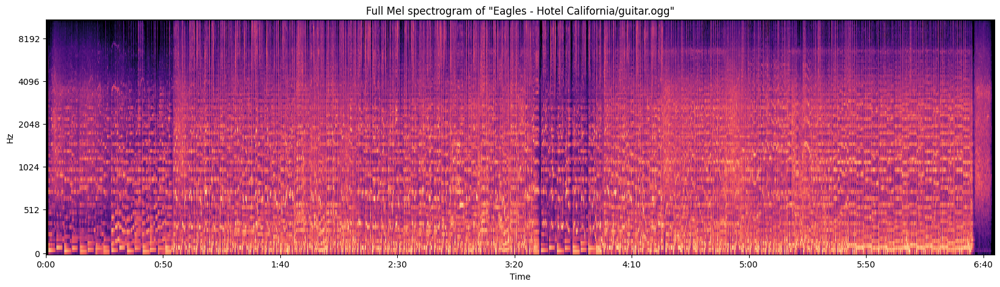

In [8]:
y, sr = librosa.load(chart_song.preview[0].path)
melspec = librosa.power_to_db(
    librosa.feature.melspectrogram(y=y, sr=sr),
    ref=np.max
)
logger.info(f"Mel spectrogram shape: {melspec.shape}")

fig, ax = plt.subplots(figsize=(20, 5))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax)
ax.set(title=f'Full Mel spectrogram of \"{clip_name}\"')
# ax.set_xlim([3, 55])
plt.show()

2024-04-20 07:17:31,176  [chartsper] [INFO]  Mel spectrogram shape: (128, 17474)


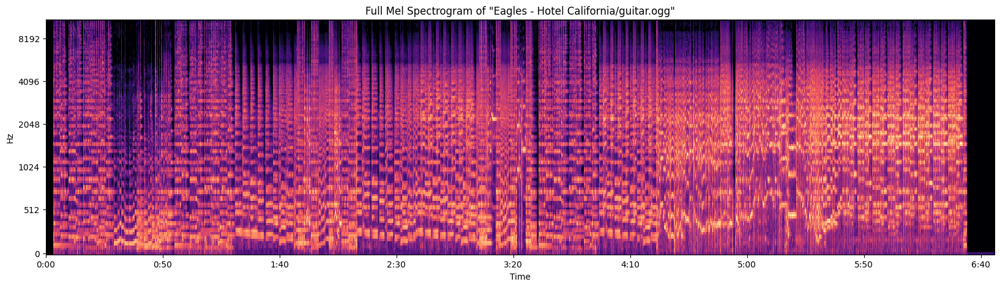

In [9]:
clip_name = os.path.join(str(chart_song.guitar[0].path.parent).split('/')[-1], chart_song.guitar[0].path.name)
y, sr = librosa.load(chart_song.guitar[0].path)
melspec = librosa.power_to_db(
    librosa.feature.melspectrogram(y=y, sr=sr),
    ref=np.max
)
logger.info(f"Mel spectrogram shape: {melspec.shape}")

fig, ax = plt.subplots(figsize=(20, 5))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax)
ax.set(title=f'Full Mel Spectrogram of \"{clip_name}\"')
# ax.set_xlim([3, 55])
plt.show()

The simple approach is to load the data and visualize it using [efficient patch generation](https://librosa.org/doc/latest/auto_examples/plot_patch_generation.html#sphx-glr-auto-examples-plot-patch-generation-py). We can use the `librosa` library to load the data and `matplotlib` to plot it.

In [10]:
frame_length = librosa.time_to_frames(5.0)
hop_length = librosa.time_to_frames(0.10)
logger.info(f"Frame length={frame_length}, hop length={hop_length}")

patches = librosa.util.frame(
    melspec,
    frame_length=frame_length,
    hop_length=hop_length
)
logger.info(f"Patch array shape: {patches.shape}")

2024-04-20 07:17:36,990  [chartsper] [INFO]  Frame length=215, hop length=4
2024-04-20 07:17:36,991  [chartsper] [INFO]  Patch array shape: (128, 215, 4315)
2024-04-20 07:17:36,991  [chartsper] [INFO]  Patch array shape: (128, 215, 4315)


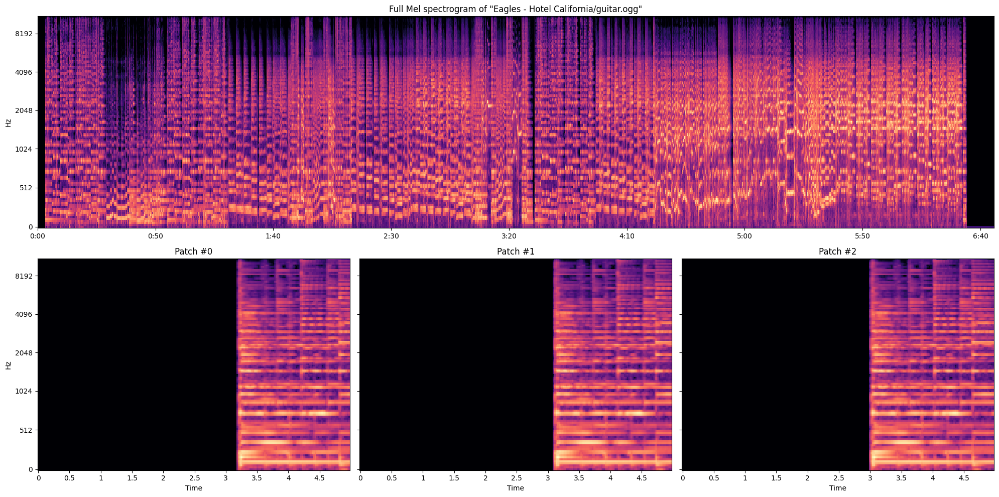

In [11]:
fig, ax = plt.subplot_mosaic([list("AAA"), list("012")], figsize=(20, 10))

librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax["A"])
ax["A"].set(title=f'Full Mel spectrogram of \"{clip_name}\"', xlabel=None)

for index in [0, 1, 2]:
    librosa.display.specshow(
        patches[..., index],
        x_axis='time',
        y_axis='mel',
        ax=ax[str(index)]
    )
    ax[str(index)].set(title=f"Patch #{index}")
    ax[str(index)].label_outer()
plt.tight_layout()

## 2.2 Chart Files

In [49]:
pm = pretty_midi.PrettyMIDI(str(chart_song.notes[0].path))

In [50]:
melspec.shape

(128, 17474)

In [54]:
import math

sr = 22050  # tasa de muestreo
hop_length = 512  # número de muestras entre frames sucesivos

# Calcula la tasa de frames por segundo (FPS)
audio_duration = pm.get_end_time()  # Duración del audio en segundos
mel_fps = math.ceil(sr / hop_length)

piano_roll = pm.instruments[0].get_piano_roll(mel_fps)[96:101]
piano_roll.shape

(5, 17334)

In [56]:
import math

math.ceil(pm.get_end_time() * mel_fps)

17744

In [57]:
import numpy as np
import math

sr = 22050  # tasa de muestreo
hop_length = 512  # número de muestras entre frames sucesivos
# Calcula la tasa de frames por segundo (FPS)
mel_fps = sr / hop_length

# Asumiendo que 'pretty_midi_midi' es tu objeto PrettyMIDI
audio_duration = pm.get_end_time()  # Duración del audio en segundos
expected_frames = math.ceil(audio_duration * mel_fps)  # Número de frames esperado, redondeado hacia arriba

# Ahora utiliza expected_frames para determinar el número de columnas en el piano roll
piano_roll = pm.get_piano_roll(fs=mel_fps)[:, :expected_frames]
piano_roll.shape


(128, 16966)

There are 0 time signature changes
There are 4 instruments: PART GUITAR, PART BASS, PART DRUMS, PART VOCALS

PART GUITAR
-----------
  * 6163 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0


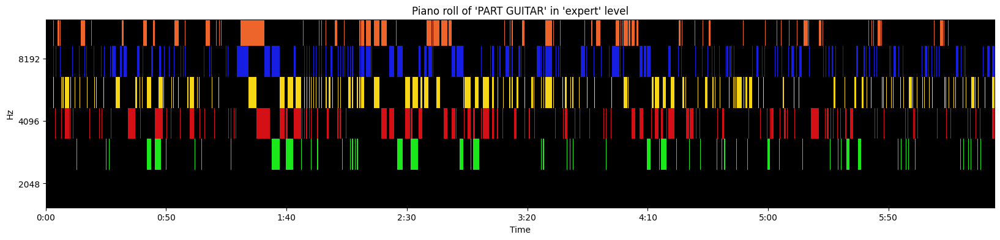

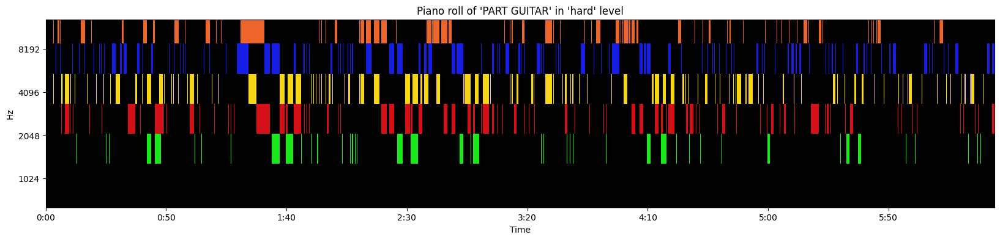

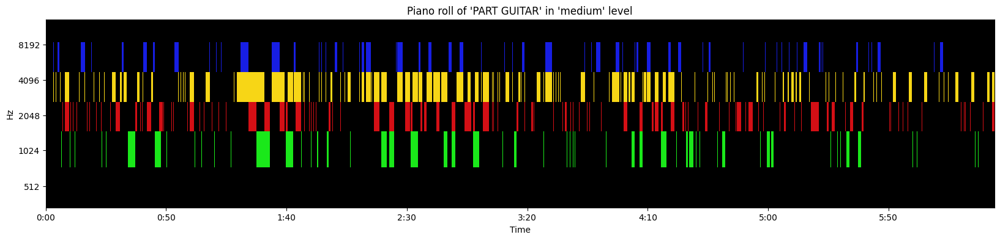

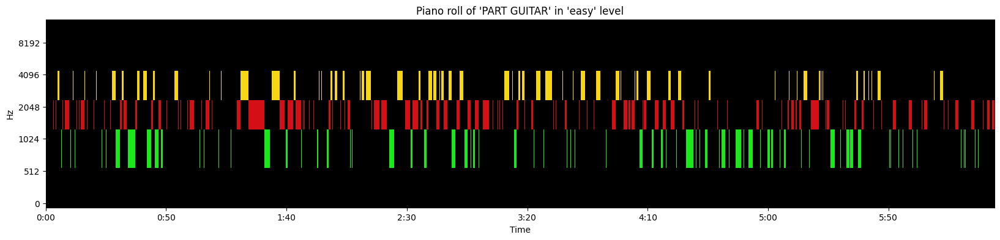


PART BASS
---------
  * 4788 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0

PART DRUMS
----------
  * 4065 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0

PART VOCALS
-----------
  * 493 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0


In [58]:
print(f"There are {len(pm.time_signature_changes)} time signature changes")
print(f"There are {len(pm.instruments)} instruments: {", ".join([instrument.name for instrument in pm.instruments])}")
for instrument in pm.instruments:
    print(f"\n{instrument.name}\n{len(instrument.name) * '-'}")
    print(f"  * {len(instrument.notes)} notes")
    print(f"  * {len(instrument.pitch_bends)} pitch bends")
    print(f"  * {len(instrument.control_changes)} control changes")
    print(f"  * Program -> {instrument.program}")

    if instrument.name == 'PART GUITAR':
        for level in LEVEL_MAPING.keys():
            ax = plot_piano_roll(
                instrument,
                *LEVEL_MAPING.get(level)['pitch_lims'],
                fs=mel_fps,
                cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get(level)['colors']),
                x_axis='time',
                y_axis='mel'
            )
            ax.set_title(f"Piano roll of '{instrument.name}' in '{level}' level")
            # ax.set_xlim(3, 23)
            # ax.set_xlim(27.5, 39)
            # ax.set_xlim(3, 55)
            plt.show()


In [59]:
len(y) /sr

405.7317006802721

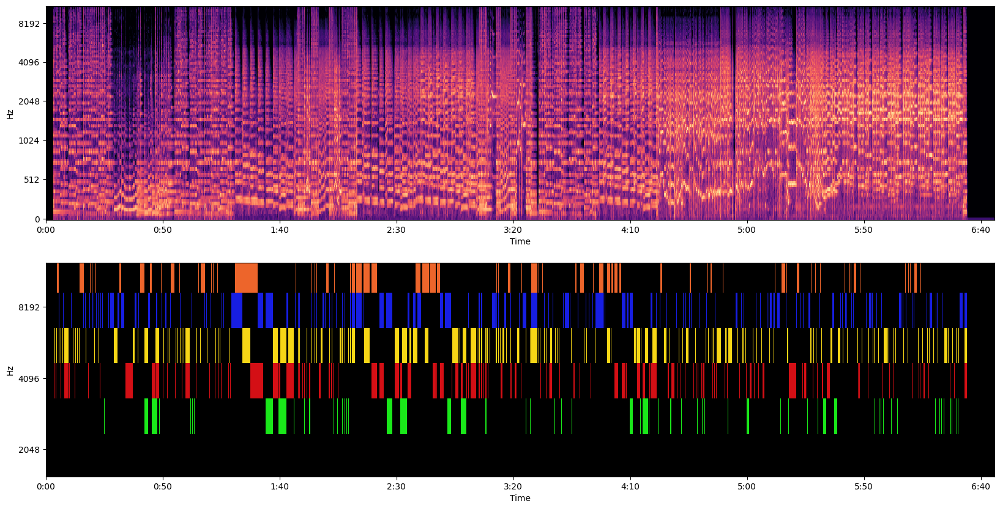

In [61]:
fig, axes = plt.subplots(2, 1, figsize=(20, 10))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=axes[0])
axes[1] = plot_piano_roll(
    pm.instruments[0],
    *LEVEL_MAPING.get('expert')['pitch_lims'],
    fs=mel_fps,
    cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
    y_axis='mel',
    ax=axes[1]
)
axes[1].set_xlim(0, len(y)/sr)
axes[1].set_facecolor('black')
# ax.set_title(f"Piano roll of '{pm.instruments[0].name}' in 'expert' level")
# ax.set_xlim(3, 23)
# ax.set_xlim(27.5, 39)
# for ax in axes:
#     ax.set_xlim(3, 55)
plt.show()



In [62]:
chartspec = replace_notes_by_colors(pm.instruments[0], *LEVEL_MAPING.get('expert')['pitch_lims'])
frame_length = librosa.time_to_frames(5.0)
hop_length = librosa.time_to_frames(0.10)
print(f"Frame length={frame_length}, hop length={hop_length}")

patches = librosa.util.frame(
    chartspec,
    frame_length=frame_length,
    hop_length=hop_length
)
print(f"Patch array shape: {patches.shape}")

Frame length=215, hop length=4
Patch array shape: (6, 215, 9796)


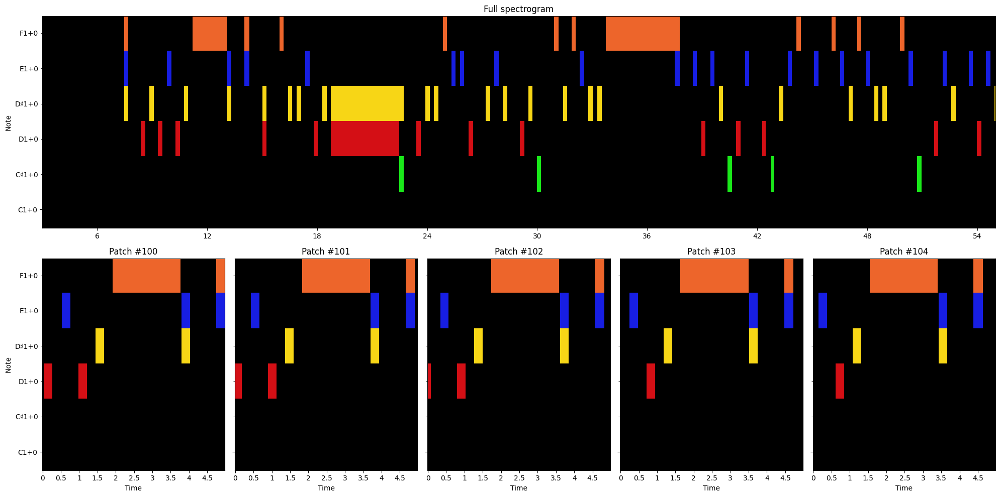

In [63]:
fig, ax = plt.subplot_mosaic([list("A"*5), ['100', '101', '102', '103', '104']], figsize=(20, 10))

librosa.display.specshow(
    chartspec,
    x_axis='time',
    y_axis='cqt_note',
    cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
    ax=ax["A"]
)
ax["A"].set(title='Full spectrogram', xlabel=None)
ax["A"].set_xlim([3, 55])

for index in [100, 101, 102, 103, 104]:
    librosa.display.specshow(
        patches[..., index],
        x_axis='time',
        y_axis='cqt_note',
        cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
        ax=ax[str(index)]
    )
    ax[str(index)].set(title=f"Patch #{index}")
    ax[str(index)].label_outer()
plt.tight_layout()
plt.show()

<a id="3-target-transformation"></a>
# 3. Target Transformation

## 3.1 Graph Representation

In [26]:
def replace_values_by_notes(
    piano_roll: np.ndarray,
    start_pitch: int,
    end_pitch: int,
) -> np.ndarray:
    for idx, row in zip(range(start_pitch, end_pitch + 1, 1), piano_roll):
        for index, value in enumerate(row):
            if value > 0:
                row[index] = idx
    return piano_roll

In [31]:
matrix = replace_values_by_notes(pm.get_piano_roll(math.ceil(mel_fps))[95:101], 95, math.ceil(mel_fps))
matrix.shape

(6, 17334)

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter


def format_time(x, pos):
    """
    Formatea el tiempo en segundos a minutos:segundos.
    
    Args:
    x (float): El valor del tick en segundos.
    pos (int): La posición del tick (no usada en este formateador).
    
    Returns:
    str: El tiempo formateado como minutos:segundos.
    """
    minutes = int(x // 60)
    seconds = int(x % 60)
    return f'{minutes}:{seconds:02}'

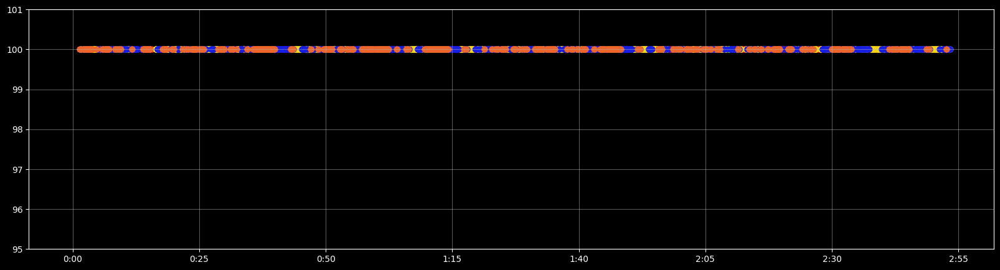

In [33]:
hop_length = 1
sr = 100
num_columns = matrix.shape[1]
total_time = num_columns * hop_length / sr
time_axis = np.linspace(0, total_time, num_columns)

# times = [pm.tick_to_time(tick) for tick in range(len(matrix[0]))]

fig, ax = plt.subplots(figsize=(20, 5), facecolor='k')
for idx, row in zip(range(95, 101), matrix):
    ax.scatter(time_axis, row, label=f'C{idx}', color=LEVEL_MAPING['expert']['colors'][idx - 95])
# plt.scatter(range(len(matrix[1])), matrix[1], color=LEVEL_MAPING['expert']['colors'][1], marker='*', label='C#5')
ax.xaxis.set_major_formatter(FuncFormatter(format_time))
ax.set_ylim(95, 101)
# plt.xlim(3, 13)
ax.grid('--', alpha=0.5)
ax.set_facecolor('black')

ax.spines['bottom'].set_color('w')
ax.spines['top'].set_color('w') 
ax.spines['right'].set_color('w')
# ax.spines['right'].set_linewidth(3)
ax.spines['left'].set_color('w')
# ax.spines['left'].set_lw(3)
ax.xaxis.label.set_color('w')
ax.yaxis.label.set_color('w')
ax.tick_params(colors='w', which='both')

plt.show()

In [39]:
import pretty_midi
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt


def replace_values_by_notes(
    piano_roll: np.ndarray,
    start_pitch: int,
    end_pitch: int,
) -> np.ndarray:
    for idx, row in zip(range(start_pitch, end_pitch + 1, 1), piano_roll):
        for index, value in enumerate(row):
            if value > 0:
                row[index] = idx
    return piano_roll


def get_time_axis(matrix, hop_length, sr):
    num_columns = matrix.shape[1]
    total_time = num_columns * hop_length / sr
    return np.linspace(0, total_time, num_columns)


def create_note_graph(piano_roll, fs):
    """
    Crea un grafo de las notas basado en el piano roll, representando tanto conexiones horizontales como verticales.
    
    Args:
    piano_roll (np.ndarray): Matriz de piano roll donde las filas representan notas y las columnas pasos de tiempo.
    fs (int): Frecuencia de muestreo utilizada para generar el piano roll.
    
    Returns:
    G (networkx.Graph): El grafo de notas.
    """
    # Crear un grafo vacío
    G = nx.Graph()
    
    # Obtener el número de notas y pasos de tiempo
    num_notes, num_steps = piano_roll.shape
    
    # Añadir nodos al grafo
    for note in range(num_notes):
        for time_step in range(num_steps):
            if piano_roll[note, time_step] > 0:
                # Crear un nodo por cada nota activa en cada paso de tiempo
                node_id = f'{note}_{time_step}'
                G.add_node(node_id, pos=(time_step / fs, note), label=f'Nota {note}')
                
                # Conectar con el nodo anterior en el tiempo si también es una nota activa
                if time_step > 0 and piano_roll[note, time_step - 1] > 0:
                    prev_node_id = f'{note}_{time_step - 1}'
                    G.add_edge(prev_node_id, node_id)
                
                # Conectar con las notas simultáneas en el mismo paso de tiempo
                if time_step < num_steps - 1:
                    for other_note in range(num_notes):
                        if other_note != note and piano_roll[other_note, time_step] > 0:
                            other_node_id = f'{other_note}_{time_step}'
                            G.add_edge(node_id, other_node_id)
                            
    return G


def plot_graph(G, ax):
    """
    Visualiza el grafo de notas.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    """
    pos = nx.get_node_attributes(G, 'pos')
    labels = nx.get_node_attributes(G, 'label')
    nx.draw(G, pos, ax, labels=labels, node_size=50, with_labels=False, node_color='lightblue', edge_color='gray')
    plt.xlim(3, 3.5)
    # plt.title('Grafo de Notas MIDI')
    # plt.xlabel('Tiempo (s)')
    # plt.ylabel('Nota MIDI')
    # plt.show()
    return ax

In [45]:
def plot_graph(G, ax):
    """
    Visualiza el grafo de notas.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    """
    pos = nx.get_node_attributes(G, 'pos')
    labels = nx.get_node_attributes(G, 'label')
    nx.draw(G, pos, ax, labels=labels, node_size=50, with_labels=False, node_color='lightblue', edge_color='gray')
    plt.xlim(3, 6)
    # plt.title('Grafo de Notas MIDI')
    # plt.xlabel('Tiempo (s)')
    # plt.ylabel('Nota MIDI')
    # plt.show()
    return ax

<Axes: >

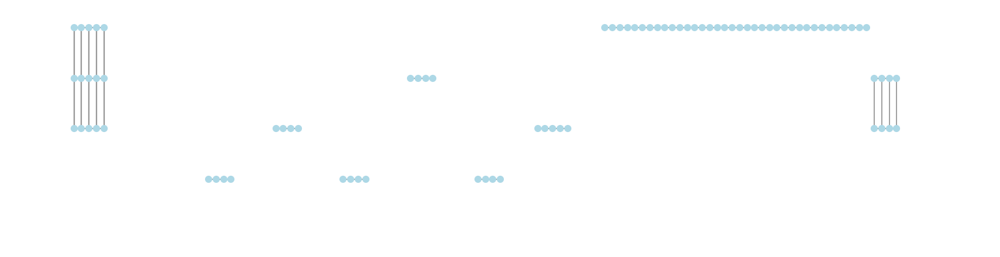

In [46]:
# piano_roll = pm.instruments[0].get_piano_roll(fs=100)[95:101]
piano_roll = replace_values_by_notes(pm.instruments[0].get_piano_roll(math.ceil(mel_fps))[96:101], 96, math.ceil(mel_fps))
G = create_note_graph(piano_roll, math.ceil(mel_fps))
fig, ax = plt.subplots(figsize=(20, 5))
plot_graph(G, ax=ax)
# ax = plt.gca()
# ax.set_xlim(3, 55)


In [81]:
def find_first_element(value,array):
    return next(filter(lambda x:array[x]==value,range(len(array))),-1)

find_first_element(100.0, piano_roll[4])

322

In [91]:
piano_roll[:,320:420]

array([[  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,  97.,  97.,
         97.,  97.,  97

In [51]:
import matplotlib.cm as cm


def create_note_graph(piano_roll, fs):
    """
    Crea un grafo de las notas basado en el piano roll, representando tanto conexiones horizontales como verticales,
    y asignando un color único a cada tipo de nota.
    
    Args:
    piano_roll (np.ndarray): Matriz de piano roll donde las filas representan notas y las columnas pasos de tiempo.
    fs (int): Frecuencia de muestreo utilizada para generar el piano roll.
    
    Returns:
    G (networkx.Graph): El grafo de notas.
    color_map (list): Lista de colores para cada nodo.
    """
    # Crear un grafo vacío
    G = nx.Graph()
    color_map = []
    
    # Encontrar las notas únicas presentes en el piano roll
    unique_notes = np.unique(np.where(piano_roll > 0)[0])
    num_unique_notes = len(unique_notes)
    
    # Asignar un color a cada nota única
    color_palette = cm.get_cmap('nipy_spectral', num_unique_notes)
    note_to_color = {note: color_palette(i) for i, note in enumerate(unique_notes)}

    # Añadir nodos al grafo
    node_color = []
    for note in range(piano_roll.shape[0]):
        for time_step in range(piano_roll.shape[1]):
            if piano_roll[note, time_step] > 0:
                node_id = f'{note}_{time_step}'
                G.add_node(node_id, pos=(time_step / fs, note), label=f'Nota {note}')
                # color_map.append(colormap.get(piano_roll[note, time_step]))
                node_color.append(note_to_color[note])
                
                # Conectar con el nodo anterior en el tiempo si también es una nota activa
                if time_step > 0 and piano_roll[note, time_step - 1] > 0:
                    prev_node_id = f'{note}_{time_step - 1}'
                    G.add_edge(prev_node_id, node_id)
                
                # Conectar con las notas simultáneas en el mismo paso de tiempo
                if time_step < piano_roll.shape[1] - 1:
                    for other_note in range(num_notes):
                        if other_note != note and piano_roll[other_note, time_step] > 0:
                            other_node_id = f'{other_note}_{time_step}'
                            G.add_edge(node_id, other_node_id)
                            
    return G, node_color

def plot_graph(G, node_color, ax):
    """
    Visualiza el grafo de notas con colores únicos para cada tipo de nota.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    color_map (list): Lista de colores para cada nodo.
    """
    pos = nx.get_node_attributes(G, 'pos')
    labels = nx.get_node_attributes(G, 'label')
    nx.draw(G, pos, ax=ax, node_color=node_color, labels=labels, node_size=50, with_labels=False, edge_color='gray')
    plt.title('Grafo de Notas MIDI')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Nota MIDI')
    plt.show()

In [52]:
def plot_graph(G, node_color, ax):
    """
    Visualiza el grafo de notas con colores únicos para cada tipo de nota.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    color_map (list): Lista de colores para cada nodo.
    """
    pos = nx.get_node_attributes(G, 'pos')
    labels = nx.get_node_attributes(G, 'label')
    nx.draw(G, pos, ax=ax, node_color=node_color, labels=labels, node_size=50, with_labels=False, edge_color='gray')
    plt.xlim(3, 3.5)
    plt.title('Grafo de Notas MIDI')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Nota MIDI')
    plt.show()

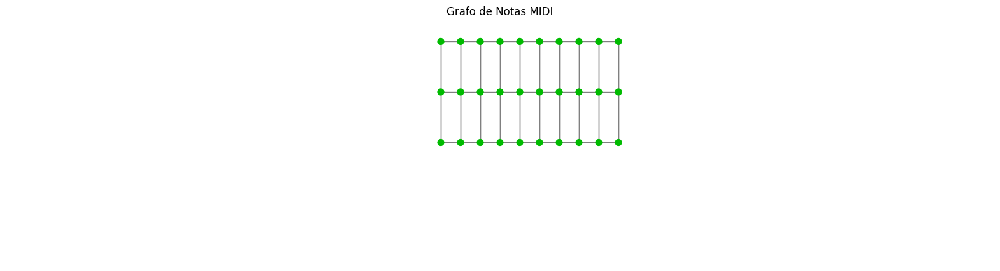

In [53]:
G, node_color = create_note_graph(piano_roll, sr)
fig, ax = plt.subplots(figsize=(20, 5))
plot_graph(G, node_color=node_color, ax=ax)
# ax = plt.gca()
# ax.set_xlim(3, 55)


In [47]:
import pretty_midi
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.cm as cm

def create_note_graph(piano_roll, fs):
    """
    Crea un grafo de las notas basado en el piano roll, representando tanto conexiones horizontales como verticales.
    Cada nota tiene un color único.
    
    Args:
    piano_roll (np.ndarray): Matriz de piano roll donde las filas representan notas y las columnas pasos de tiempo.
    fs (int): Frecuencia de muestreo utilizada para generar el piano roll.
    
    Returns:
    G (networkx.Graph): El grafo de notas.
    node_color (list): Lista de colores para cada nodo basado en la nota que representan.
    """
    # Crear un grafo vacío
    G = nx.Graph()
    
    # Encontrar las notas únicas presentes en el piano roll
    unique_notes = np.unique(np.where(piano_roll > 0)[0])
    num_unique_notes = len(unique_notes)
    
    # Asignar un color a cada nota única
    color_palette = cm.get_cmap('nipy_spectral', num_unique_notes)
    note_to_color = {note: color_palette(i) for i, note in enumerate(unique_notes)}
    
    # Añadir nodos y aristas al grafo
    node_color = []
    for time_step in range(piano_roll.shape[1]):
        active_notes = np.where(piano_roll[:, time_step] > 0)[0]
        for note in active_notes:
            node_id = f'{note}_{time_step}'
            G.add_node(node_id, pos=(time_step / fs, note))
            node_color.append(note_to_color[note])
            
            # Conectar con el nodo de la misma nota en el paso de tiempo anterior
            if time_step > 0 and piano_roll[note, time_step - 1] > 0:
                prev_node_id = f'{note}_{time_step - 1}'
                G.add_edge(prev_node_id, node_id)
            
            # Conectar con otros nodos activos en este paso de tiempo para formar acordes
            for other_note in active_notes:
                if note != other_note:
                    other_node_id = f'{other_note}_{time_step}'
                    G.add_edge(node_id, other_node_id)
    
    return G, node_color

def plot_graph(G, node_color, ax = None):
    """
    Visualiza el grafo de notas con colores únicos para cada tipo de nota.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    node_color (list): Lista de colores para cada nodo.
    """
    pos = nx.get_node_attributes(G, 'pos')
    nx.draw(G, pos, ax=ax, node_color=node_color, with_labels=False, node_size=50, edge_color='gray')
    plt.xlim(3, 13)
    plt.title('Grafo de Notas MIDI')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Nota MIDI')
    plt.show()




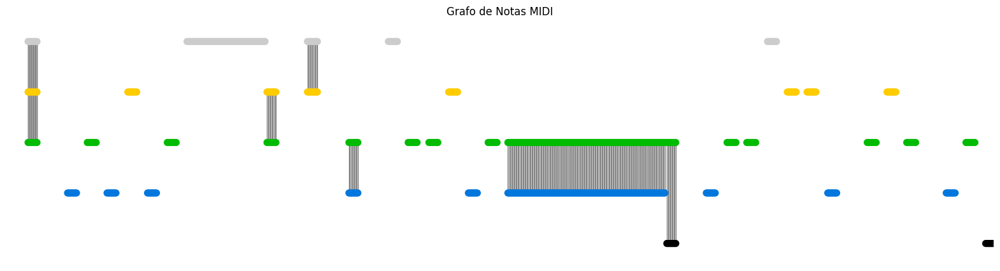

In [48]:
G, node_color = create_note_graph(piano_roll, sr)
fig, ax = plt.subplots(figsize=(20, 5))
plot_graph(G, node_color=node_color, ax=ax)
# ax = plt.gca()
# ax.set_xlim(3, 55)

In [69]:
import pretty_midi
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.cm as cm

def create_note_graph(piano_roll, fs):
    """
    Crea un grafo dirigido de las notas basado en el piano roll, con bordes temporales etiquetados como "temporal".
    
    Args:
    piano_roll (np.ndarray): Matriz de piano roll donde las filas representan notas y las columnas pasos de tiempo.
    fs (int): Frecuencia de muestreo utilizada para generar el piano roll.
    
    Returns:
    G (networkx.DiGraph): El grafo dirigido de notas.
    node_color (list): Lista de colores para cada nodo basado en la nota que representan.
    """
    # Crear un grafo dirigido vacío
    G = nx.DiGraph()
    
    # Encontrar las notas únicas presentes en el piano roll
    unique_notes = np.unique(np.where(piano_roll > 0)[0])
    num_unique_notes = len(unique_notes)
    
    # Asignar un color a cada nota única
    color_palette = cm.get_cmap('nipy_spectral', num_unique_notes)
    note_to_color = {note: color_palette(i) for i, note in enumerate(unique_notes)}
    print(note_to_color)
    
    # Añadir nodos y aristas al grafo
    node_color = []
    for time_step in range(piano_roll.shape[1]):
        active_notes = np.where(piano_roll[:, time_step] > 0)[0]
        
        for note in active_notes:
            node_id = f'{note}_{time_step}'
            G.add_node(node_id, pos=(time_step / fs, note))
            node_color.append(note_to_color[note])
            
            # Conectar con el nodo de la misma nota en el paso de tiempo anterior con un borde temporal
            if time_step > 0 and piano_roll[note, time_step - 1] > 0:
                prev_node_id = f'{note}_{time_step - 1}'
                G.add_edge(prev_node_id, node_id, tipo='temporal')
            
            # Conectar con otros nodos activos en este paso de tiempo para formar acordes
            # Estos bordes no son temporales, así que no agregamos el atributo "tipo"
            for other_note in active_notes:
                if note != other_note:
                    other_node_id = f'{other_note}_{time_step}'
                    G.add_edge(node_id, other_node_id)

    print(active_notes)
    
    return G, node_color

In [70]:
G, node_color = create_note_graph(piano_roll, fs=sr)

{52: (0.0, 0.0, 0.0, 1.0), 54: (0.2592777777777778, 0.0, 0.2962777777777778, 1.0), 57: (0.4741, 0.0, 0.5407111111111111, 1.0), 59: (0.5111, 0.0, 0.5777666666666667, 1.0), 60: (0.4147888888888889, 0.0, 0.6148222222222222, 1.0), 61: (0.11851111111111101, 0.0, 0.6518777777777778, 1.0), 62: (0.0, 0.0, 0.7333666666666667, 1.0), 63: (0.0, 0.0, 0.8444777777777777, 1.0), 64: (0.0, 0.20742222222222217, 0.8667, 1.0), 65: (0.0, 0.4667, 0.8667, 1.0), 66: (0.0, 0.5407555555555555, 0.8667, 1.0), 67: (0.0, 0.607411111111111, 0.8444777777777779, 1.0), 69: (0.0, 0.6444666666666666, 0.7333666666666666, 1.0), 72: (0.0, 0.6667, 0.6370555555555555, 1.0), 73: (0.0, 0.6667, 0.5629444444444446, 1.0), 74: (0.0, 0.6444666666666667, 0.3555333333333338, 1.0), 75: (0.0, 0.6074111111111111, 0.059255555555555395, 1.0), 76: (0.0, 0.6592444444444444, 0.0, 1.0), 77: (0.0, 0.7333, 0.0, 1.0), 78: (0.0, 0.8074111111111111, 0.0, 1.0), 84: (0.0, 0.8815111111111111, 0.0, 1.0), 85: (0.0, 0.9555666666666665, 0.0, 1.0), 86: (0.

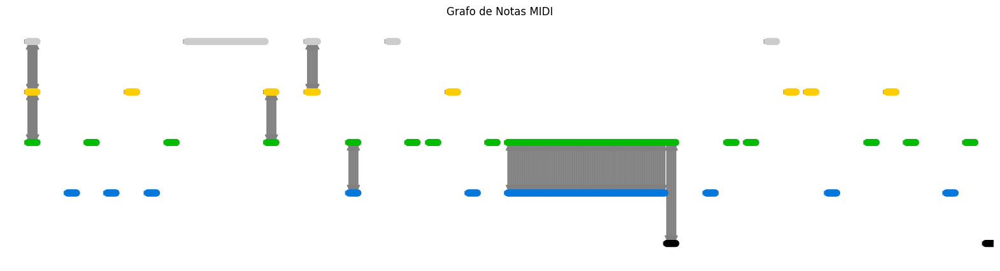

In [38]:
# Ejemplo de uso
# midi_data = pretty_midi.PrettyMIDI('/mnt/data/your_midi_file.mid')
# piano_roll = midi_data.get_piano_roll(fs=100)
G, node_color = create_note_graph(piano_roll, fs=sr)
fig, ax = plt.subplots(figsize=(20, 5))
plot_graph(G, node_color, ax)
# ax = plt.gca()
# ax.set_xlim(3, 13)


In [88]:
def plot_graph(G, node_color, ax = None):
    """
    Visualiza el grafo de notas con colores únicos para cada tipo de nota.
    
    Args:
    G (networkx.Graph): El grafo de notas.
    node_color (list): Lista de colores para cada nodo.
    """
    pos = nx.get_node_attributes(G, 'pos')
    nx.draw(G, pos, ax=ax, node_color=node_color, with_labels=False, node_size=50, edge_color='gray')
    plt.xlim(3, 3.7)
    plt.title('Grafo de Notas MIDI')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Nota MIDI')
    plt.show()

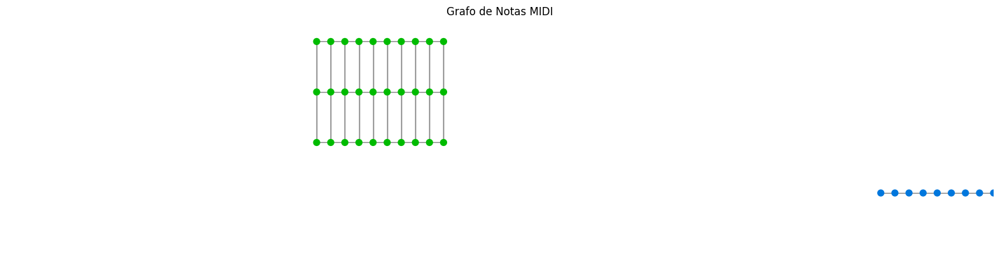

In [89]:
fig, ax = plt.subplots(figsize=(20, 5))
plot_graph(G, node_color, ax)

In [254]:
# Convertir el grafo a una matriz de adyacencia
adj_matrix = nx.to_numpy_array(G)

# Convertir el grafo a una lista de bordes, incluyendo los datos de los bordes
edges_with_data = np.array(G.edges(data=True))

# Si sólo quieres los nodos conectados sin datos adicionales
edges_without_data = np.array(G.edges())


In [256]:
adj_matrix.shape

(36792, 36792)

In [259]:
type(edges_with_data

numpy.ndarray

In [260]:
edges_without_data

array([['2_322', '3_322'],
       ['2_322', '4_322'],
       ['2_322', '2_323'],
       ...,
       ['2_39395', '3_39395'],
       ['3_39395', '1_39395'],
       ['3_39395', '2_39395']], dtype='<U7')

In [262]:
sr

22050